In [1]:
########################################################################
##### /!\ THIS NOTEBOOK SOULD BE RUN ON DATARMOR (JUPYTER HUB) /!\ #####
########################################################################

If you don't want to use datarmor, I can set up the dataset to be downloaded in local but it might take a bit of storage.

In [2]:
### Imports

import pandas as pd
import xarray as xr
import numpy as np
import glob
import matplotlib.pyplot as plt
import proplot as pplt

In [3]:
### Files of interest

df_files = ['/home/datawork-cersat-project/mpc-sentinel1/analysis/s1_data_analysis/project_rmarquar/wsat/datasets/IW/size_24000/res_200/S1A_IW_OCN__2SDV_20190319T172820_20190319T172851_026410_02F4A1_CA43/s1a-iw-ocn-vv-20190319t172637-20190319t172712-026410-02F4A1-001_wsat_20190319v7.0.1/df_s1a-iw-ocn-vv-20190319t172637-20190319t172712-026410-02F4A1-001_wsat_20190319v7.0.1.csv',
 '/home/datawork-cersat-project/mpc-sentinel1/analysis/s1_data_analysis/project_rmarquar/wsat/datasets/IW/size_24000/res_200/S1A_IW_OCN__2SDV_20190413T180900_20190413T180935_026775_030206_F089/s1a-iw-ocn-vv-20190413t180537-20190413t180615-026775-030206-001_wsat_20190413v7.0.1/df_s1a-iw-ocn-vv-20190413t180537-20190413t180615-026775-030206-001_wsat_20190413v7.0.1.csv',
 '/home/datawork-cersat-project/mpc-sentinel1/analysis/s1_data_analysis/project_rmarquar/wsat/datasets/IW/size_24000/res_200/S1A_IW_OCN__2SDV_20190821T182343_20190821T182408_028671_033EB7_1C99/s1a-iw-ocn-vv-20190821t182225-20190821t182258-028671-033EB7-001_wsat_20190821v7.0.1/df_s1a-iw-ocn-vv-20190821t182225-20190821t182258-028671-033EB7-001_wsat_20190821v7.0.1.csv',
 '/home/datawork-cersat-project/mpc-sentinel1/analysis/s1_data_analysis/project_rmarquar/wsat/datasets/IW/size_24000/res_200/S1A_IW_OCN__2SDV_20191027T070435_20191027T070500_029641_036024_A476/s1a-iw-ocn-vv-20191027t070227-20191027t070257-029641-036024-001_wsat_20191027v7.0.1/df_s1a-iw-ocn-vv-20191027t070227-20191027t070257-029641-036024-001_wsat_20191027v7.0.1.csv',
 '/home/datawork-cersat-project/mpc-sentinel1/analysis/s1_data_analysis/project_rmarquar/wsat/datasets/IW/size_24000/res_200/S1A_IW_OCN__2SDV_20190129T182032_20190129T182057_025696_02DAE6_3580/s1a-iw-ocn-vv-20190129t181644-20190129t181717-025696-02DAE6-001_wsat_20190129v7.0.1/df_s1a-iw-ocn-vv-20190129t181644-20190129t181717-025696-02DAE6-001_wsat_20190129v7.0.1.csv']

Each of these files contains different windfields that should return a different result for the scattering transform.

In [4]:
### Read dataframe

df_example = pd.read_csv(df_files[0])
df_example

,lon,lat,reference_angle,wsat_angle,heading_angle,incidence_angle,rain_wsat,wind_speed_wsat,nrcs_copol_mean,nrcs_crosspol_mean,sar_date,wsat_date,delta_time,file_path,sar_L1_path,sar_L2_path,wsat_path
0,-1.375,64.875,50.336044,39.0,348.663956,31.313303,0.0,11.0,0.116433,0.001568,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
1,-1.125,64.625,54.939593,43.5,348.560407,31.652197,0.0,9.8,0.090954,0.001148,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
2,-1.125,64.875,51.837164,40.5,348.662836,32.098350,0.0,10.6,0.092454,0.001289,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
3,-0.875,64.125,68.644991,57.0,348.355009,31.583580,0.0,10.0,0.087960,0.000904,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
4,-0.875,64.375,64.043282,52.5,348.456718,32.016518,0.1,9.6,0.080482,0.000965,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,3.375,64.375,46.043325,34.5,348.456675,44.154156,2.2,17.8,0.042952,0.002611,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
108,3.375,64.625,57.940325,46.5,348.559675,44.400270,2.6,17.2,0.040947,0.002498,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
109,3.625,63.875,43.246688,31.5,348.253312,44.313366,0.9,18.8,0.045286,0.002948,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...
110,3.625,64.125,52.144413,40.5,348.355587,44.548046,1.3,18.6,0.043610,0.002755,2019-03-19 17:26:37,2019-03-19 16:54:00,1957.0,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...,/home/datawork-cersat-project/mpc-sentinel1/an...


This dataframe contains 112 rows which means 112 pictures are associated with it. Their paths is stored in the column 'file_path'. The reference angle ('reference_angle') is stored among others values of interest such as the rain rate ('rain_wsat'), the wind speed ('wind_speed_wsat')...

In [5]:
### Open a picture (netCDF file)

pic = xr.open_dataset(df_example['file_path'].iloc[0])
pic

<xarray.Dataset>
Dimensions:         (atrack: 121, pol: 2, xtrack: 121)
Coordinates:
  * pol             (pol) object 'VV' 'VH'
  * atrack          (atrack) float64 1.649e+04 1.65e+04 ... 1.884e+04 1.886e+04
  * xtrack          (xtrack) float64 350.0 370.0 390.0 ... 2.73e+03 2.75e+03
Data variables:
    sigma0          (pol, atrack, xtrack) float64 ...
    sigma0_detrend  (pol, atrack, xtrack) float64 ...
    longitude       (atrack, xtrack) float32 ...
    latitude        (atrack, xtrack) float32 ...
    incidence       (atrack, xtrack) float32 ...
Attributes: (12/16)
    start_date:       2019-03-19 17:28:20.556363
    heading_angle:    348.66395606569756
    wsat_angle:       39.0
    reference_angle:  50.33604393430244
    sar_date:         2019-03-19 17:26:37
    wsat_date:        2019-03-19 16:54:00
    ...               ...
    rain_wsat:        0.0
    wsat_path:        /home/datawork-cersat-public/project/mpc-sentinel1/anal...
    sar_L1_path:      SENTINEL1_DS:/home/datawork-cersat-project/mpc-sentinel...
    sar_L2_path:      /home/datawork-cersat-project/mpc-sentinel1/data/esa/se...
    coloc_path:       /home/datawork-cersat-project/mpc-sentinel1/analysis/s1...
    filename:         /home/datawork-cersat-project/mpc-sentinel1/analysis/s1...

The picture is stored is an xarray dataset. It is the Radar Cross Section retrieved by the SAR and two polaeizations are available: VV and VH. Let's open the NRCS in VV polarization and display it.

(Text(0.5, 0, 'atrack'), Text(0, 0.5, 'xtrack'))

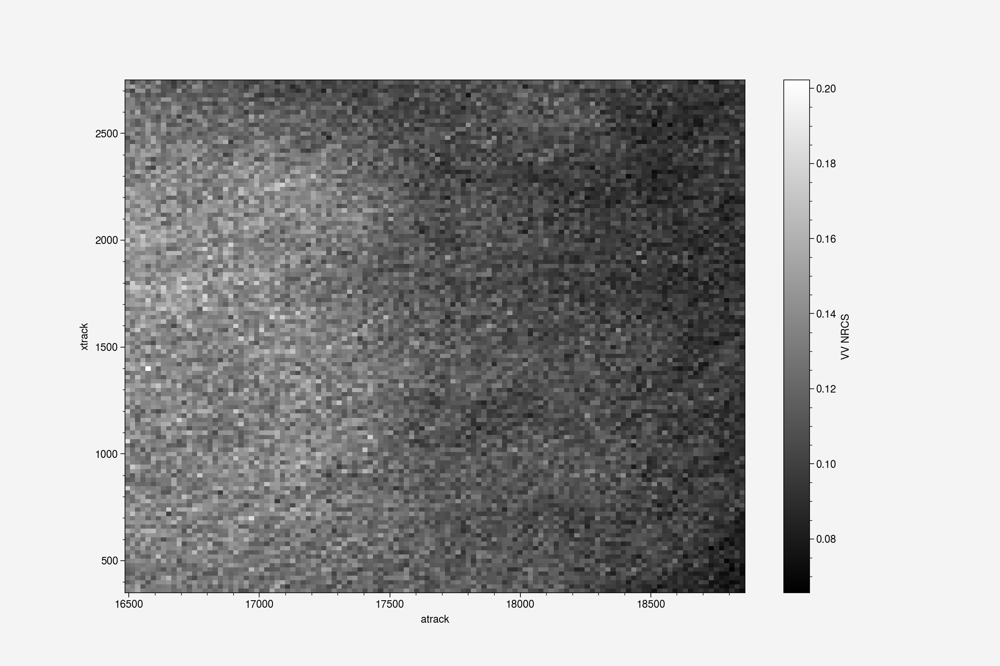

In [6]:
sigma0_VV = pic['sigma0'].sel(pol = 'VV').values # .values give a numpy array which might be more handy for your computations.

plt.figure(figsize=(12,8))
cm = plt.pcolormesh(pic['atrack'].values, pic['xtrack'].values, sigma0_VV, cmap = 'gray')
plt.colorbar(cm, label = 'VV NRCS')
plt.xlabel('atrack'), plt.ylabel('xtrack')

The same can be done for VH polarization but also for the detrended signal.

(Text(0.5, 0, 'atrack'), Text(0, 0.5, 'xtrack'))

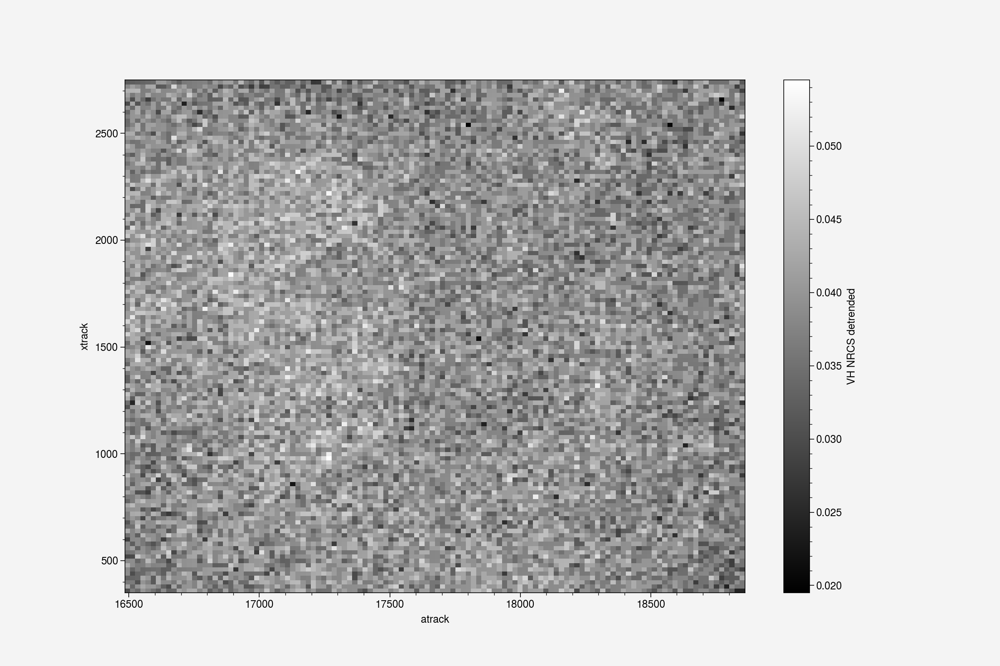

In [7]:
sigma0_detrend_VH = pic['sigma0_detrend'].sel(pol = 'VH').values

plt.figure(figsize=(12,8))
cm = plt.pcolormesh(pic['atrack'].values, pic['xtrack'].values, sigma0_detrend_VH, cmap = 'gray')
plt.colorbar(cm, label = 'VH NRCS detrended')
plt.xlabel('atrack'), plt.ylabel('xtrack')

It would be interresting to see the differents results of the scattering tranforms for the different channels. Maybe you can try for the detrended NRCS (sigma0_detrend) in VV polarization, and I will look up the others possibilities when you will present me your code ?

In [8]:
### To get all the different pictures and their reference angles stored in a list, you can run this cell

dataframes = list(map(pd.read_csv, df_files))
pictures = []
reference_angles = []

for df in dataframes:    
    pictures += [xr.open_dataset(file)['sigma0_detrend'].sel(pol = 'VV').values for file in df['file_path']]
    reference_angles += df['reference_angle'].to_list()
    
print('Dataset size: {}'.format(len(pictures)))

Dataset size: 404


---
**Notebook modified from here**  *by Edouard Gauvrit (edouard.gauvrit@ifremer.fr)*
# WST Analysis 

To perform the WST analysis we will use the library [pywst](https://github.com/bregaldo/pywst) to compute the different scattering coefficients.\
There is an introductive [tutorial](https://github.com/bregaldo/pywst/blob/master/examples/tutorial.ipynb) (made by Bruno Regaldo) that shows in more details the different usage of this lib.

## Definition :
Before to start to compute some WST coefficients, we will brefely remind what is the main idea behind WST.
The Wavelet Scattering Transform is based on successive layer of convolutions (usually 2) of a signal with [Morlet wavelets](https://en.wikipedia.org/wiki/Morlet_wavelet) ($\psi$). Those wavelets are defined by their scale and orientation (respectively $j$ and $\theta$). 

At the first layer the signal is scan by a set of walets {$\psi_{j_1,\theta_1}$}, which can be seen as a resample of the initial signal at the different scales $j_1$. Then, a modulus operation is applied and we take the average over the whole field. We get the first order coefficients, defined as :
$S_1 = <|I*\psi_{j_1,\theta_1}|>$ , where $I$ is our signal. (*$S_1$ is equivalent to the power spectrum but expressed in L1-norm*)

We repeat the same operation on the resampled signal and we end up with second order coefficients : 
$S_2 = <||I*\psi_{j_1,\theta_1}|*\psi_{j_2,\theta_2}|>$\
$S_2$ gives the modulation at a scale $j_2$ (and orientation $\theta_2$) of a certain feature seen at $j_1$ (and $\theta_1$), **in other words it provides a quantification of the coupling between scales**. 

In [9]:
import pywst as pw

## Let's look at the data :
It is better to normalize the data before to apply WST operators, but we can first try without doing so.

In [10]:
def normalize(x):
    return (x - x.mean())/x.std()

batch = np.array([normalize(p)+abs(p.min()) for p in pictures])

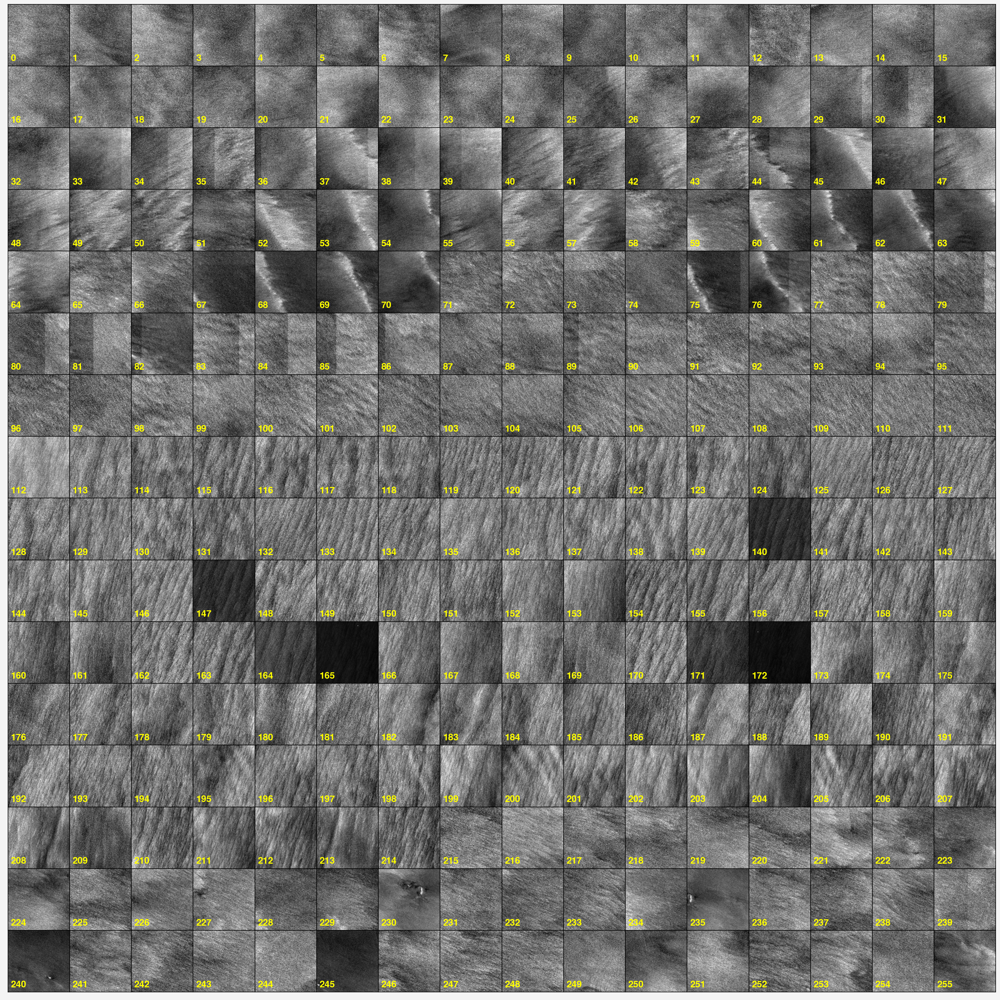

In [11]:
def plotMaps(fig,axs,batch,fs=10):
    axs.format(xticks=[],yticks=[])
    for i,(ax,b) in enumerate(zip(axs,batch)):
        ax.imshow(b,cmap='gray',aspect='auto')    
        ax.text(5,b.shape[1]-10,'%d'%(i),fontsize=fs,fontweight='bold',color='yellow')

# ======================================
# We just display the first 256 images :
# ======================================
fig = pplt.figure(space=0,figsize=(15,15))
axs = fig.subplots(nrows=16,ncols=16)
plotMaps(fig,axs,batch[:256])

## Size extension :
Because `pywst` works only on $2^n$ fields, we have to zero padd our batch of pictures.

In [12]:
def extend(X,size,periodic=False):
    nn, ny, nx = X.shape
    shx, shy  = (size-nx)//2, (size-ny)//2
    Xn = np.zeros((nn,size,size))
    Xn[:,:ny,:nx] = X
    Xn = np.roll(Xn,(shx,shy),axis=(1,2))
    return Xn

batch_ext = extend(batch,128)
batch_ext.shape

(404, 128, 128)

## Configuration :
### Set up the bank of wavelets
Now, lets define our wavelet parameters by setting :
* **M, N** : the image size (`pywst` *works only with size proportionnal to the power of 2*)
* **J** : the maximal scale we want to probe (*corresponding at $2^J$*)
* **L** : the number of angles in which the interval $[0,\pi]$ is divided

Note that the set of wavelets will cover all the scales $2^j$ for $j = 0,1,...,J$.

In [13]:
*_, M, N = batch_ext.shape # Height and width of the map
J  = 6 # Here we will probe up to the scale 2^6
L  = 8 
OS = 0 # No oversampling

### We now create WST (or RWST) operators :
RWST stands for Reduced-WST and corresponds to the projection of the WST coefficients along the maximal angle of anisotropy.\
Thus instead to have ($j_1,\theta_1,j_2,\theta_2$) depedencies we only account for ($j_1,j_2$).\
Its use offers a second drop in dimensionality and makes more easier the interpretation of the coefficients.\
But we have to keep in mind that we can loose information, especially for isotropic fields.

In [14]:
# ==========================================
# We create here both WST & RWST operators :
# ==========================================
wst_op  = pw.WSTOp(M, N, J, L, OS)
rwst_op = pw.RWSTOp(M,N,J,L,OS,wst_op=wst_op) 

## Computation :
Now we use the `.apply` method to compute the WST & RWST coefficients. This method can be perform directly on a set of images but.\
Because in our case data are not satisfying the periodic boundary condition, local coefficients at the borders must be cropped.\
To do so we just set `crop=1`. Width of the cropping in $2^J$ pixels unit before downsampling.

In [15]:
# =======================================
# We now apply our operators to one map :
# =======================================
idmap = 132 # map ID (why 132 --> 1+3&2 = 42, the answer to everything !!! :p)
I = batch_ext[idmap] 
wst_map  = wst_op.apply(I,crop=1)
rwst_map = rwst_op.apply(I,crop=1)

So, in our case the cropped image will correspond to the center square of width $2^6 = 64$.

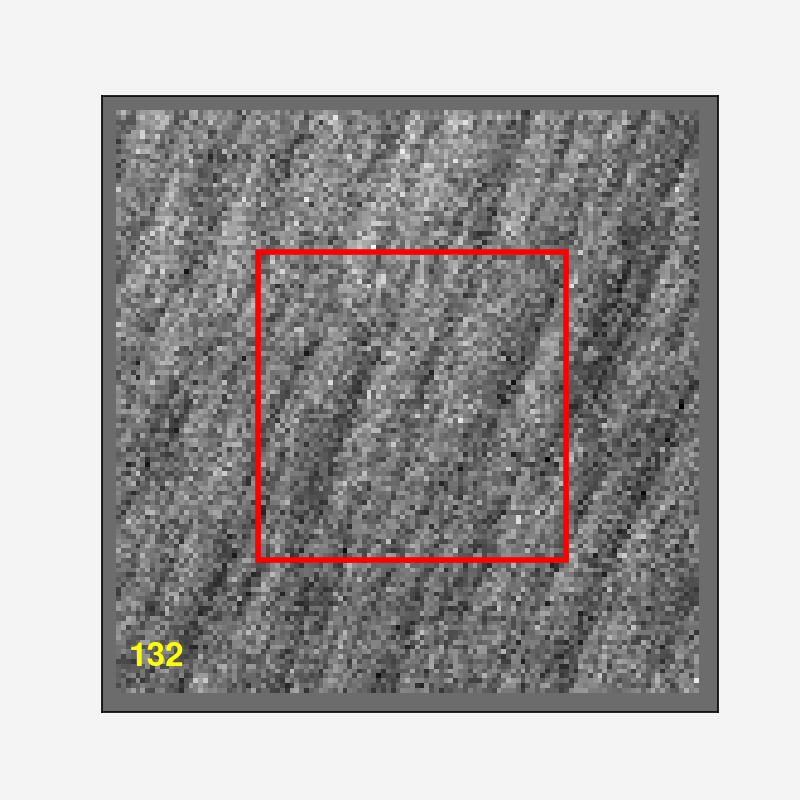

In [16]:
import matplotlib.patches as patches
smax = 2**J # maximal scale
fig, ax = plt.subplots()
ax.set_xticks([]);ax.set_yticks([]);
ax.imshow(I,cmap='gray')
ax.text(5,I.shape[1]-10,'%d'%(idmap),fontsize=12,fontweight='bold',color='yellow')
ax.add_patch(patches.Rectangle((smax//2,smax//2),smax,smax,lw=2,fill=False,edgecolor='r'));

## WST Coefficients :
As we have seen before there is 2 layer of convolutions which give 2 order of coefficients.
We can display the different WST coefficients with the `.plot` method.\
But before we need to convert our WST coefs into a $\log_2$ form and normalize them, in order to compare them with RWST coefficients.

In [17]:
wst_map.to_log2()   # log2 conversion
wst_map.normalize() # normalization 

Note that since now our WST coefs contained in `wst_map` have changed. To unormalize and linearize them we can use the `.unormalize()` and `.to_linear()` methods respectively.

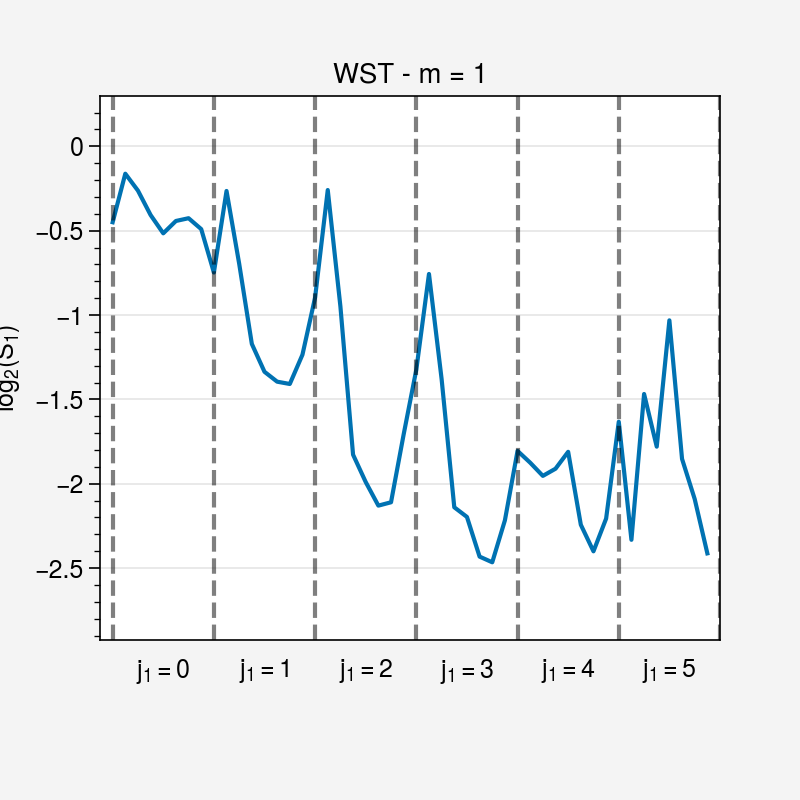

In [18]:
# ==============
# Layer 1 = S1 
# ==============
wst_map.plot(layer=1)

For each value of $j_1$ there is $L(=8)$ subdivision of $\theta_1$. 

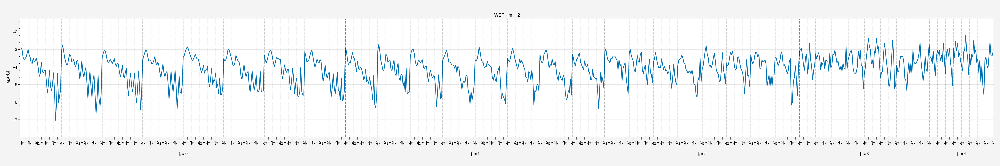

In [19]:
# ==============
# Layer 2 = S2 
# ==============
wst_map.plot(layer=2)

It appears for both $\bar S_1$ and $\bar S_2$ coefficients a certain angular regularity. We can imagine to perform a reduction of this angular dependency, which is what RWST does.

## RWST coefs. :
Let's print now the different coefficients contained in `rwst_map`, by using `.model`.

In [20]:
print(rwst_map.model)

Model: RWSTModel1
--> Layer 0 coefficient: S0
--> Layer 1 coefficients: S1Iso - S1Aniso - ThetaRef1
--> Layer 2 coefficients: S2Iso1 - S2Iso2 - S2Aniso1 - S2Aniso2 - ThetaRef2


We now briefly recall the RWST model, but more details are given in [Allys et al. (2019)](https://arxiv.org/abs/1905.01372).
As we can see there is a layer 0, with only one coefficient $S_0$ which gives the average value of the map.

For the first layer, the $S_1$ coef can be decomposed as :\
[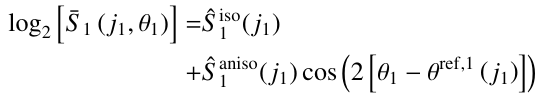](image.png)

with,
- $\hat S_1^{iso}(j_1) \equiv$ **isotropic** term **independent of $\theta_1$**
- $\hat S_1^{aniso}(j_1) \equiv$ **anisotropic** part **proportional to** a $\pi$-periodic cosine function of **$\theta_1$**
- $\theta^{ref}_1 (j_1) \equiv$ reference **angle** related to the direction **of anisotropy** (*i.e. privileged direction in the map*)

We can plot these coefs. with the sa

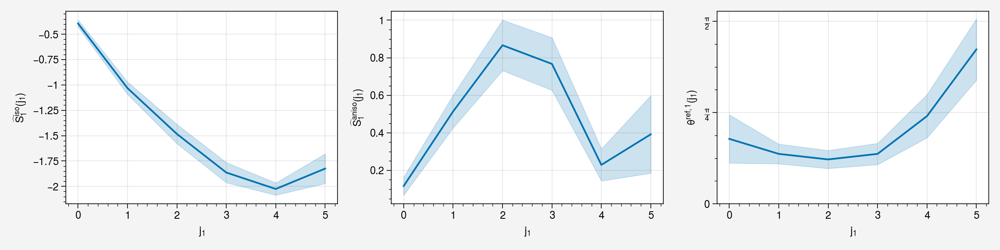

In [21]:
rwst_map.plot(['S1Iso','S1Aniso','ThetaRef1'])

### Reconstruction
*pywst* provides a way to compare the RWST and WST statistics with the `.plot_compare()` method.

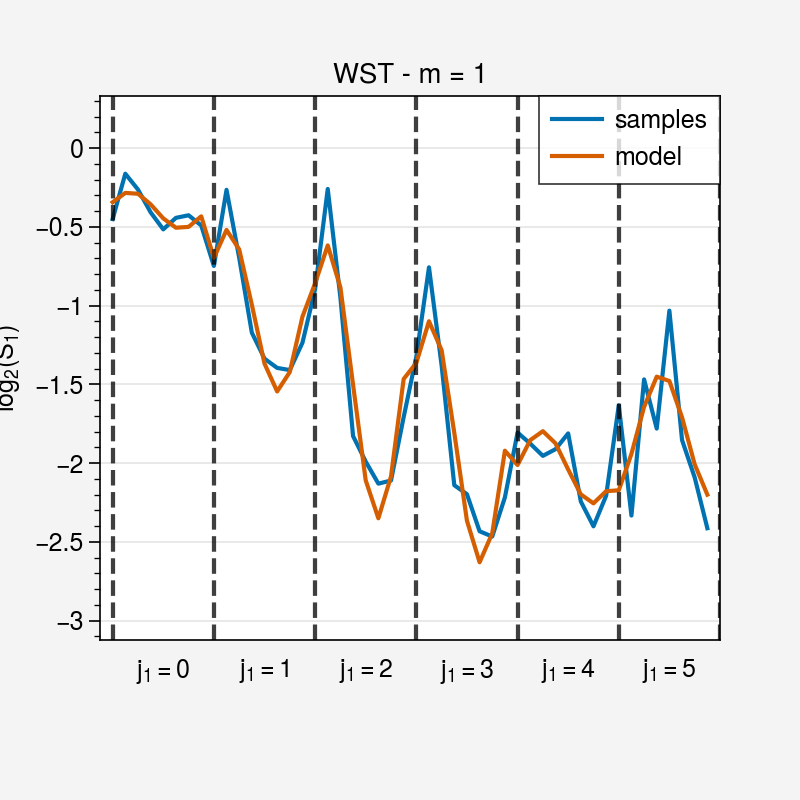

In [22]:
wst_map.plot_compare(rwst_map, layer=1, labels=['samples', 'model'])

One can see a good agreement between WST and RWST coefficients for this image, we can assume that the field may be statistically
anisotropic.

For the second layer, $S_2$ is decomposed as :

[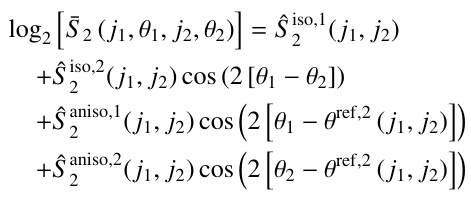](image.png)

with,

- $\hat S_2^{iso,1} \equiv$ amplitude of coupling between the scales $j_1$ and $j_2$
- $\hat S_2^{iso,2} \equiv$ amplitude of the modulation due to the relative orientation of the wavelets $\psi_{j_1,\theta_1}$ and $\psi_{j_2,\theta_2}$ $\rightarrow$  can be seen as a **signature of filamentary structures** at a given scale.
- $\hat S_2^{aniso,1}$ and $\hat S_2^{aniso,1} \equiv$ anisotropic properties of the data (*decoupling $\theta_1$ and $\theta_2$ contributions*)


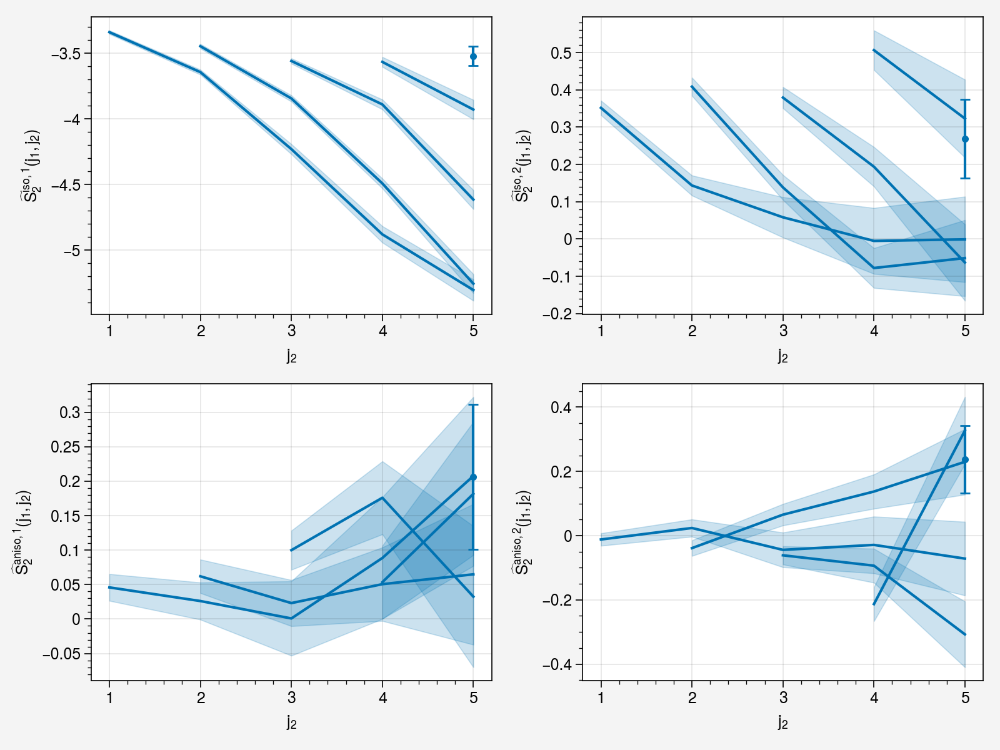

In [23]:
rwst_map.plot(['S2Iso1','S2Iso2','S2Aniso1','S2Aniso2'])

Each curves correspond to a specific value of $j_1$. For example, if we look at the top left panel ($\hat S_2^{iso,1}$) the longest curve represents the smallest scales (i.e. $j_1=0$). The second is for $j_1=1$, and so on till $j_1=4$. At the second order we always look at scales $j_2>j_1$, because it is useless to see below the filtered scales. 

## Short aside on the coupling between scales
When we are talking about coupling across scales, we refer to the notion of structure into our signal.

To understand what really $\hat S_2^{iso,1}$ measures and why we should look at it, we will analyse and compare an image with high level of structures (*i.e. high degree of non-Gaussianities*) with another one showing no structure (*i.e. purely Gaussian*).

For that, let's take a racoon picture (left). We can clearly see many different patterns which compose this image (*racoon's coat, the shape of its face, the grass, etc..*).\
These structures are actually encoded in the coupling between scales. Now let's randomize the phase of the first image to end up with a Gaussian field (right).

In [24]:
def phaseRandomize(x):
    '''
    Returns a phase-randomized version of the input data X.
    '''
    Nx,Ny = x.shape
    Nx,Ny = int(Nx),int(Ny)
    # Get spectrum :
    Y = np.fft.fft2(x)
    # Get Magnitude :
    Mag = abs(Y)
    # Get phases : 
    Ang = np.angle(Y)
    # Add random phase shifts
    rnd_theta = -np.pi + (2*np.pi) * np.random.rand(Nx,Ny)  
    Y_new = Mag * np.exp(1j*rnd_theta)
    X_new = np.fft.ifft2(Y_new)
    
    return X_new


def powerspec2D(I):
    nx, ny = I.shape
    ft = np.fft.fftshift(np.fft.fft2(I))
    return abs(ft)**2/(nx**2*ny**2)


def azimuthalAverage(image, center=None):
    """
    Calculate the azimuthally averaged radial profile.

    image - The 2D image
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the image (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the image
    y, x = np.indices(image.shape)
    if not center:
        center = np.array([(x.max()-x.min())/2.0, (x.max()-x.min())/2.0])
    r = np.hypot(x - center[0], y - center[1])

    # Get sorted radii
    ind = np.argsort(r.flat)
    r_sorted = r.flat[ind]
    i_sorted = image.flat[ind]

    # Get the integer part of the radii (bin size = 1)
    r_int = r_sorted.astype(int)

    # Find all pixels that fall within each radial bin.
    deltar = r_int[1:] - r_int[:-1]  # Assumes all radii represented
    rind = np.where(deltar)[0]       # location of changed radius
    nr = rind[1:] - rind[:-1]        # number of radius bin
    
    # Cumulative sum to figure out sums for each radius bin
    csim = np.cumsum(i_sorted, dtype=float)
    tbin = csim[rind[1:]] - csim[rind[:-1]]

    radial_prof = tbin / nr

    return radial_prof

In [25]:
# ===============================================
# We import the racoon face image (isn't he cut?)
# ===============================================
import scipy.misc
data = scipy.misc.face(gray=True)[:512]
data = normalize(data)
# ===============================================
# We import the racoon face image (isn't he cut?)
# ===============================================
data_pr = phaseRandomize(data)

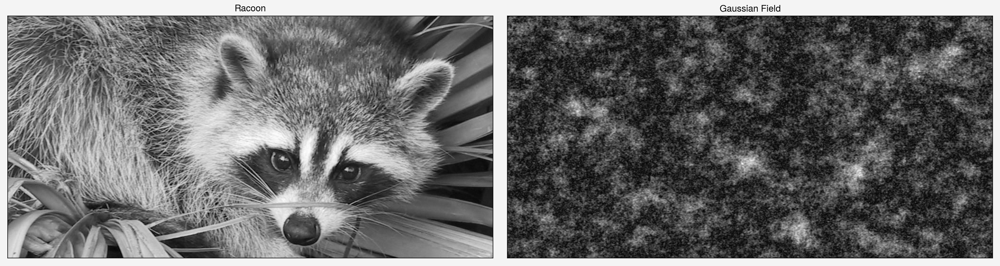

In [26]:
titles = ['Racoon','Gaussian Field','Diff.']
fig, axs = pplt.subplots(ncols=2,nrows=1,figsize=(15,4))
for ax,d,tlt in zip(axs,[data,abs(data_pr)],titles):
    ax.imshow(d,cmap='gray')
    ax.format(grid=False,xticks=[],yticks=[],title=tlt)
# ============================================================    

Now let's look at these two images through the scope of the power spectrum and the $\hat S_2^{iso,1}$ coefficients.  

In [28]:
# ===========================================
# We compute the RWST coefs. for the 2 images
# ===========================================
*_, M, N = data.shape # Height and width of the map
rwst_op2 = pw.RWSTOp(M,N,8,L,OS)
rwst_racoon = rwst_op2.apply(np.array([data+abs(data.min()),data_pr+abs(data_pr.min())]),crop=1)

In [29]:
# =======================================================
# And we compute the power spectrum (radially integrated)
#                 for the 2 images
# =======================================================
iy,ix = 512,256 

ps2d_data = powerspec2D(data)
ps1d_data = azimuthalAverage(ps2d_data,center=[iy,ix])

ps2d_data_pr = powerspec2D(data_pr)
ps1d_data_pr = azimuthalAverage(ps2d_data_pr,center=[iy,ix])

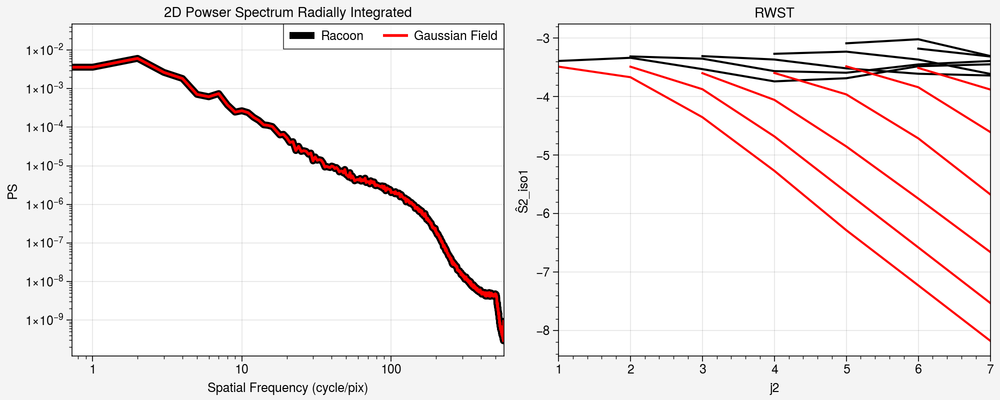

In [30]:
fig, ax = pplt.subplots(ncols=2,nrows=1,figsize=(10,4),share=False)
ax[0].loglog(ps1d_data,lw=5,c='k',label='Racoon')
ax[0].loglog(ps1d_data_pr,lw=2,c='r',label='Gaussian Field')
ax[0].format(xlabel='Spatial Frequency (cycle/pix)',ylabel='PS',title='2D Powser Spectrum Radially Integrated',yformatter='sci')
ax[0].legend(loc=1)

coefs = rwst_racoon.get_coeffs('S2Iso1')
j2 = np.arange(8)
clr = ['k','r']
for i in range(2):
    for s2 in coefs[...,i]:
        idx = np.where(s2!=0)[0]
        ax[1].plot(j2[idx],s2[idx],c=clr[i])
ax[1].format(xlabel='j2',ylabel='Ŝ2_iso1',title='RWST')

As we can see on these plots, the power spectrum doesn't see the difference between the 2 images (Racoon vs Gaussian field), while the $\hat S_2^{iso,1}$ coefficients clearly show a much more organisation for the racoon (*keep in mind that $\hat S_2^{iso,1}$ is given in $\log_2$* !!).

# Go back to our SAR dataset :
We now apply the RWST operator to our batch of SAR images.

In [31]:
rwst_batch = rwst_op.apply(batch_ext,crop=1)

## Structure Classification 
We propose here to classify the different structures observed on the SAR images, thanks to the RWST coefficients.\
We first need to extract the different RWST coefs. To do so we use the `.get_coeffs()` method and specifying which variable we want (S1Iso, ThetaRef1, S2Iso1,...).

In [32]:
# ===================================
#  Here we extract some coefs. and 
#   store them into a 2D matrix 
#        (Nimages x Ncoefs) 
# ===================================
params1 = ['S1Iso','S1Aniso']
params2 = ['S2Iso1','S2Iso2']

coefs1  = np.array([rwst_batch.get_coeffs(p) for p in params1]).reshape(len(params1)*J,batch.shape[0])
coefs2  = np.array([rwst_batch.get_coeffs(p).reshape(J**2,batch.shape[0]) for p in params2]).reshape(len(params2)*J**2,batch.shape[0])

RWST_coefs = np.concatenate((coefs1,coefs2),axis=0).T
RWST_coefs.shape

(404, 84)

### Data Reduction :

In [33]:
nb = batch_ext.shape[1]
nc = RWST_coefs.shape[1]
print('from {} pix/image to {} coefs/image --> data reduction of {:.2f}%'.format(nb**2,nc,(nb**2-nc)/nb**2*100))

from 16384 pix/image to 84 coefs/image --> data reduction of 99.49%


Now we project each vector of RWST coefs (1 x Ncoefs) through a 2 component PCA. We use Kmeans to separate into `ncluster` groups.

In [34]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

ncluster = 4 # nb of class
color = ['red','blue','yellow','orange','purple','green','darkblue','darkred']

pca = PCA(n_components=2)
y = pca.fit_transform(RWST_coefs)
kmeans = KMeans(init="random",n_clusters=ncluster,n_init=10,max_iter=300,random_state=42)
kmeans.fit(y);

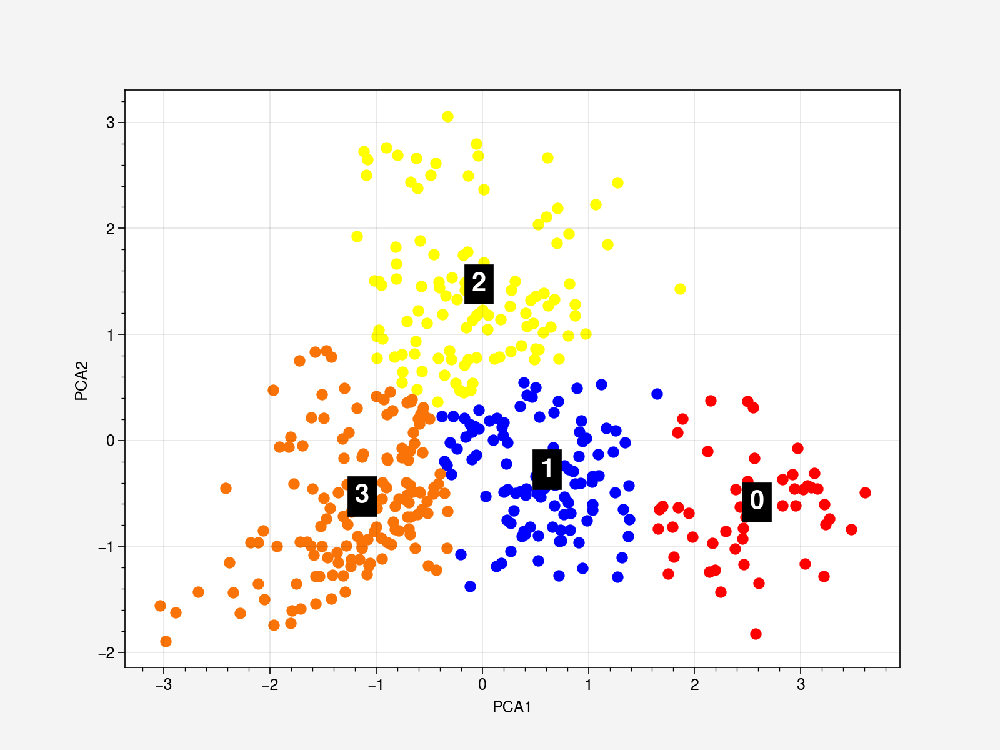

In [35]:
plt.figure(figsize=(8,6))
for i in range(ncluster):
    plt.scatter(y[kmeans.labels_==i,0],y[kmeans.labels_==i,1],color=color[i])
    plt.text(y[kmeans.labels_==i,0].mean(),y[kmeans.labels_==i,1].mean(),'%d'%(i),fontsize=15,fontweight='bold',backgroundcolor='k',color='w')
plt.xlabel('PCA1');plt.ylabel('PCA2');

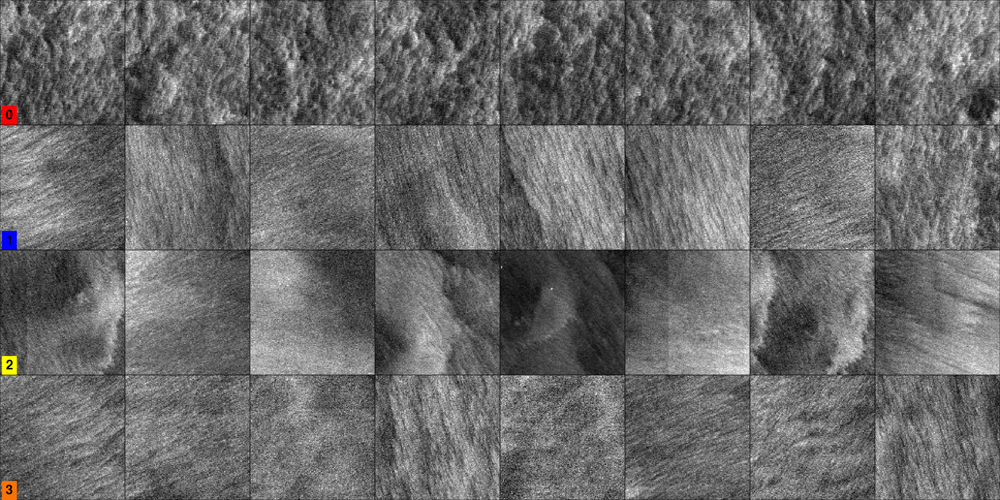

In [36]:
nplot = 8
f = plt.figure(figsize=(2*nplot,ncluster*2))
f.subplots_adjust(hspace=0.,wspace=0.,left=0.0,right=1.0,top=1.0,bottom=0.0)
for i in range(ncluster):
    x0  = y[kmeans.labels_==i,0].mean()
    y0  = y[kmeans.labels_==i,1].mean()
    iii = np.argsort((y[:,0]-x0)**2+(y[:,1]-y0)**2)
    for j in range(nplot):
        ax=plt.subplot(ncluster,nplot,1+nplot*i+j)
        plt.imshow(batch[iii[j]],cmap='gray',aspect='auto',origin='lower')
        ax.set_yticks([])
        ax.set_xticks([])
        if j==0:
            plt.text(5,5,'%d'%(i),fontsize=15,fontweight='bold',backgroundcolor=color[i],color='k')

Without much difficulty we see that the different patterns are classified with just few RWST coefficients (*the choice of `ncluster = 4` is completly arbitrary*).

## Anisotropic Angles
We can look at the different anisotropic angles in function of the scale j1.\
We need to extract first the ThetaRef1 variable for each maps.

In [37]:
theta = rwst_batch.get_coeffs('ThetaRef1').T

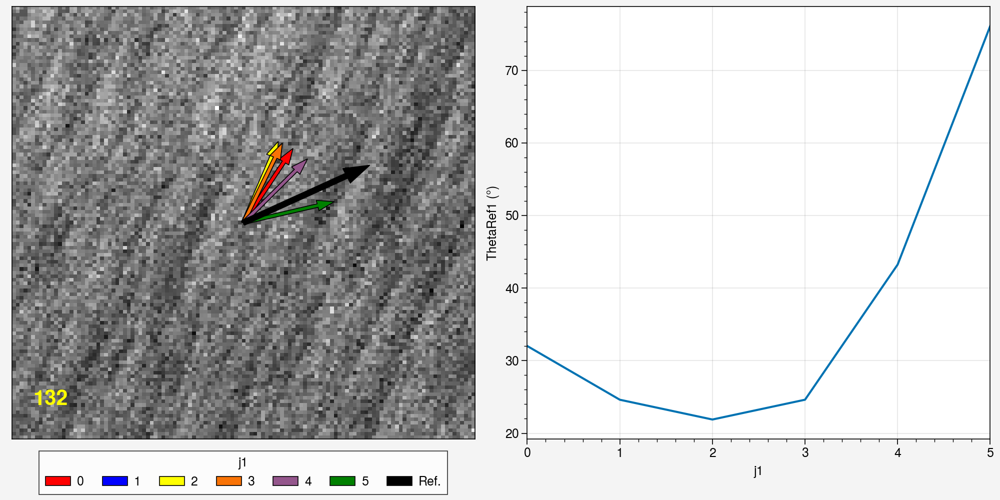

In [38]:
# ================================================
#       We can look the anisotropic angle 
#          in function of the scale j1
# ================================================
idmap = 132 # map ID

# ================================================
angle = theta[idmap] * np.pi/L - np.pi/2
ref = np.deg2rad(reference_angles[idmap])
r = 20
dx = r*np.cos(angle)
dy = r*np.sin(angle)


fig, axs = pplt.subplots(nrows=1,ncols=2,figsize=(10,5),share=False)
axs[0].imshow(batch[idmap],cmap='gray',aspect='auto')
arrows = []
labels = list(np.arange(6)).append('Ref.')
for i,(ddx,ddy,c) in enumerate(zip(dx,dy,color)):
    arrows.append(axs[0].arrow(60,60,ddx,ddy,width=1,fc=c,label=i))
arrows.append(axs[0].arrow(60,60,30*np.cos(ref),30*np.sin(ref),width=1.5,fc='k',label='Ref.'))
axs[0].legend(arrows, labels, title='j1',loc='bottom',ncols=7)
axs[0].text(5,batch[idmap].shape[1]-10,'%d'%(idmap),fontsize=15,fontweight='bold',color='yellow')
axs[1].plot(np.rad2deg(theta[idmap] * np.pi/L))
axs[0].format(xticks=[],yticks=[])
axs[1].format(xlabel='j1',ylabel='ThetaRef1 (°)')

We see a good alignement between streaks and arrows from scale $j_1 = 0$ to $j_1 = 3$. The reference angle is represented in black.

### Let's see what happens for all the other maps :

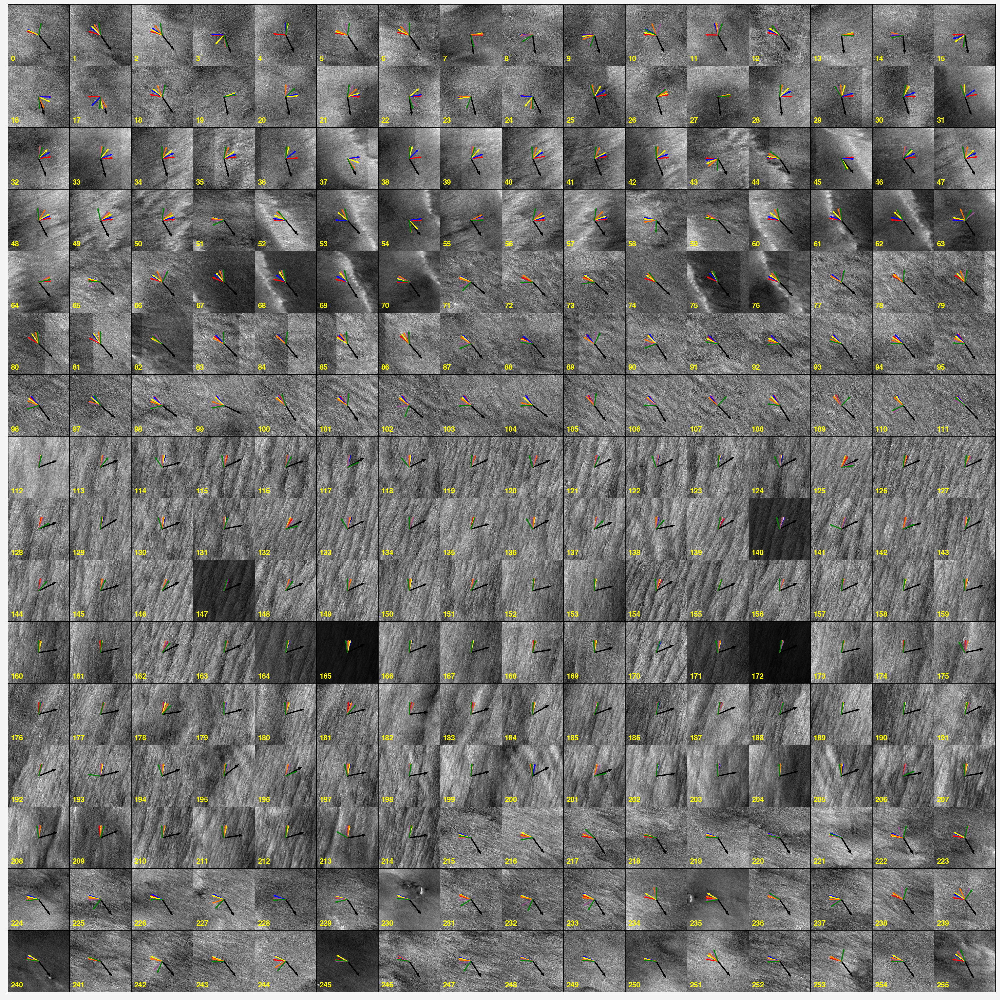

In [39]:
# ======================================
# We just display the first 256 images :
# ======================================
r = 20

fig = pplt.figure(space=0,figsize=(15,15))
axs = fig.subplots(nrows=16,ncols=16)
axs.format(xticks=[],yticks=[])
for i,(ax,b,tht) in enumerate(zip(axs,batch[:256],theta[:256])):
    ax.imshow(b,cmap='gray',aspect='auto')    
    ax.text(5,b.shape[1]-10,'%d'%(i),fontsize=8,fontweight='bold',color='yellow')
    angle = tht * np.pi/L - np.pi/2
    ref = np.deg2rad(reference_angles[i])
    dx = r*np.cos(angle)
    dy = r*np.sin(angle)
    ax.arrow(60,60,30*np.cos(ref),30*np.sin(ref),width=1.5,fc='k')
    for ddx,ddy,c in zip(dx,dy,color):
        ax.arrow(60,60,ddx,ddy,width=1,fc=c,ec=c)